# Case: Data Science Interview

### Disclaimer and ideas

In [1]:
# 1. Lightgbm (boosting) was used as model, because it outperforms other algorithms
# for tabular problems most of the time, and also require very data preparation
# for example replacing missing values or outliers, and also dont need complicated feature engineering
# on a practical scenario, other approaches could be tested

# 2. For the random search, more parameters were tested and only the best combinations were left
# in this notebook

# 3. More ideas for features (insights) in the future, for example:
# a) Macroeconomic information
# b) Regions
# c) Advertisement stragegies used
# d) combination of features (ex. multiplications and divisions)

### Imports

In [2]:
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, make_scorer
from scipy import stats
import lightgbm as lgb
import seaborn as sns
from math import sqrt
import warnings
import shap

# options
pd.options.display.float_format = '{:,.5f}'.format
pd.set_option('display.max_rows', 80)

# disable warnings
warnings.filterwarnings("ignore")

# plot inline
%matplotlib inline

### Useful methods

In [3]:
# feature importance plot
def plot_feature_importance(columns, feature_importances, max_vars):
    df_plot = pd.DataFrame({'Feature': columns, 'Feature_importance': feature_importances})
    df_plot = df_plot.sort_values(by='Feature_importance', ascending=False)
    df_plot = df_plot.query("Feature_importance > 0").reset_index(drop=True)
    plt.figure(figsize = (15,8))
    plt.title('Features importance', fontsize=14)
    df_plot_reduzido = df_plot.loc[:max_vars, :]
    plt.barh(range(len(df_plot_reduzido))[::-1], df_plot_reduzido['Feature_importance'], color="blue", align="center")
    plt.yticks(range(len(df_plot_reduzido))[::-1], df_plot_reduzido['Feature'])
    plt.show()
    return df_plot

# plot null count
def null_count(df):
    print (df.isnull().sum() * 100 / len(df))

# métricas de erro
def mae_score(true, pred):
    return mean_absolute_error(true, pred)

def mse_score(true, pred):
    return mean_squared_error(true, pred)

def rmse_score(true, pred):
    return (sqrt(mean_squared_error(true, pred)))

# rmse score
rmse_scorer = make_scorer(rmse_score, 
                          greater_is_better=False)

### Reading data

In [4]:
#df_train = pd.read_excel('INTERVIEW TRAIN SET.xlsx')
#df_train.to_pickle('df_train')
df_train = pd.read_pickle('df_train')
df_train['DATE'] = pd.to_datetime(df_train['DATE'], format='%Y%m%d', errors='ignore') 
print ('train', df_train.shape)

#df_test = pd.read_excel('INTERVIEW TEST SET.xlsx.csv')
#df_test.to_pickle('df_test')
df_test = pd.read_pickle('df_test')
df_test['DATE'] = pd.to_datetime(df_test['DATE'], format='%Y%m%d', errors='ignore') 
print ('test', df_test.shape)

train (278166, 26)
test (30237, 26)


In [5]:
df_train.head()

,ASIN_anon,DATE,BRAND,CBU,Avg_Sales_Prc,Brand_Spends,Brand_clicks,Brand_impressions,Category_Adjacent_Spends,Competitive_clicks,...,Category_search_impressions,GLANCE_VIEWS,MonthOfYear,Organic_Growth,PRIME_DAY,REP_OOS,SnSDiscount,TradePromoFlag,postCovid,ORD_UNITS
0,100,2019-05-01,M&M,CHOCOLATE,19.20000,0.00000,0,0,0.00000,0,...,0,52.00000,5,121,0,1.92000,0.08077,0,0,33
1,100,2019-05-02,M&M,CHOCOLATE,19.20000,0.00000,0,0,0.00000,0,...,0,29.00000,5,122,0,0.00000,0.08889,0,0,28
2,100,2019-05-03,M&M,CHOCOLATE,19.20000,0.00000,0,0,0.00000,0,...,0,50.00000,5,123,0,2.00000,0.11818,0,0,35
3,100,2019-05-04,M&M,CHOCOLATE,19.20000,0.00000,0,0,0.00000,0,...,0,35.00000,5,124,0,0.00000,0.10000,0,0,27
4,100,2019-05-05,M&M,CHOCOLATE,19.20000,0.00000,0,0,0.00000,0,...,0,57.00000,5,125,0,0.00000,0.08947,0,0,45


In [6]:
df_test.head()

,ASIN_anon,DATE,BRAND,CBU,Avg_Sales_Prc,Brand_Spends,Brand_clicks,Brand_impressions,Category_Adjacent_Spends,Competitive_clicks,...,Dietary_Research_impressions,GLANCE_VIEWS,MonthOfYear,Organic_Growth,PRIME_DAY,REP_OOS,SnSDiscount,TradePromoFlag,postCovid,ORD_UNITS
0,102,2020-10-09,M&M,CHOCOLATE,21.36000,0.00000,NaN,NaN,0.00000,0,...,0,NaN,10,NaN,0,75.00000,0.00000,0,1,NaN
1,104,2020-09-15,M&M,CHOCOLATE,21.36000,0.00000,NaN,NaN,0.00000,0,...,0,NaN,9,NaN,0,100.00000,0.00000,0,1,NaN
2,105,2020-09-01,M&M,CHOCOLATE,21.36000,0.00000,NaN,NaN,0.00000,0,...,0,NaN,9,NaN,0,3.57000,0.04994,0,1,NaN
3,105,2020-09-02,M&M,CHOCOLATE,21.36000,0.00000,NaN,NaN,0.00000,0,...,0,NaN,9,NaN,0,2.27000,0.05009,0,1,NaN
4,105,2020-09-03,M&M,CHOCOLATE,21.36000,0.00000,NaN,NaN,0.00000,0,...,0,NaN,9,NaN,0,2.27000,0.00000,0,1,NaN


## 1. EDA

In [7]:
# train columns
df_train.columns.tolist()

['ASIN_anon',
 'DATE',
 'BRAND',
 'CBU',
 'Avg_Sales_Prc',
 'Brand_Spends',
 'Brand_clicks',
 'Brand_impressions',
 'Category_Adjacent_Spends',
 'Competitive_clicks',
 'Competitive_impressions',
 'DOTDPrime_Day_tp_PromoFlag',
 'DOTD_SC_PromoFlag',
 'DayOfWeek',
 'Category_search_Spends',
 'Category_search_clicks',
 'Category_search_impressions',
 'GLANCE_VIEWS',
 'MonthOfYear',
 'Organic_Growth',
 'PRIME_DAY',
 'REP_OOS',
 'SnSDiscount',
 'TradePromoFlag',
 'postCovid',
 'ORD_UNITS']

In [8]:
# test columns
df_test.columns.tolist()

['ASIN_anon',
 'DATE',
 'BRAND',
 'CBU',
 'Avg_Sales_Prc',
 'Brand_Spends',
 'Brand_clicks',
 'Brand_impressions',
 'Category_Adjacent_Spends',
 'Competitive_clicks',
 'Competitive_impressions',
 'DOTDPrime_Day_tp_PromoFlag',
 'DOTD_SC_PromoFlag',
 'DayOfWeek',
 'Dietary_Research_Spends',
 'Dietary_Research_clicks',
 'Dietary_Research_impressions',
 'GLANCE_VIEWS',
 'MonthOfYear',
 'Organic_Growth',
 'PRIME_DAY',
 'REP_OOS',
 'SnSDiscount',
 'TradePromoFlag',
 'postCovid',
 'ORD_UNITS']

In [9]:
# types
df_train.dtypes

ASIN_anon                               int64
DATE                           datetime64[ns]
BRAND                                  object
CBU                                    object
Avg_Sales_Prc                         float64
Brand_Spends                          float64
Brand_clicks                            int64
Brand_impressions                       int64
Category_Adjacent_Spends              float64
Competitive_clicks                      int64
Competitive_impressions                 int64
DOTDPrime_Day_tp_PromoFlag              int64
DOTD_SC_PromoFlag                       int64
DayOfWeek                              object
Category_search_Spends                float64
Category_search_clicks                  int64
Category_search_impressions             int64
GLANCE_VIEWS                          float64
MonthOfYear                             int64
Organic_Growth                          int64
PRIME_DAY                               int64
REP_OOS                           

In [10]:
# infos
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278166 entries, 0 to 278165
Data columns (total 26 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   ASIN_anon                    278166 non-null  int64         
 1   DATE                         278166 non-null  datetime64[ns]
 2   BRAND                        278166 non-null  object        
 3   CBU                          278166 non-null  object        
 4   Avg_Sales_Prc                278166 non-null  float64       
 5   Brand_Spends                 278166 non-null  float64       
 6   Brand_clicks                 278166 non-null  int64         
 7   Brand_impressions            278166 non-null  int64         
 8   Category_Adjacent_Spends     278166 non-null  float64       
 9   Competitive_clicks           278166 non-null  int64         
 10  Competitive_impressions      278166 non-null  int64         
 11  DOTDPrime_Day_tp_PromoFlag

In [11]:
# describe
df_train.describe()

,ASIN_anon,Avg_Sales_Prc,Brand_Spends,Brand_clicks,Brand_impressions,Category_Adjacent_Spends,Competitive_clicks,Competitive_impressions,DOTDPrime_Day_tp_PromoFlag,DOTD_SC_PromoFlag,...,Category_search_impressions,GLANCE_VIEWS,MonthOfYear,Organic_Growth,PRIME_DAY,REP_OOS,SnSDiscount,TradePromoFlag,postCovid,ORD_UNITS
count,"278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000",...,"278,166.00000","277,120.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000","278,166.00000"
mean,419.69664,22.13217,1.75764,3.54105,196.74901,0.96414,0.44382,378.23709,0.00019,0.00045,...,"3,391.03346",154.65104,6.35628,330.69059,0.00439,4.00413,0.07093,0.00255,0.32157,62.29399
std,184.52433,12.54097,9.11639,16.17272,685.77829,7.60378,3.25050,"2,482.27760",0.01380,0.02128,...,"10,753.35870",395.81840,2.98262,140.95126,0.06611,14.90149,0.03702,0.05042,0.46708,152.97641
min,100.00000,0.34000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,1.00000,1.00000,0.00000,0.00000,0.00000,0.00000,0.00000,1.00000
25%,261.00000,13.01000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,33.00000,4.00000,212.00000,0.00000,0.00000,0.05010,0.00000,0.00000,8.00000
50%,417.00000,19.46000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,71.00000,6.00000,323.00000,0.00000,0.00000,0.07294,0.00000,0.00000,21.00000
75%,577.00000,28.56000,0.40000,1.00000,59.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,"2,255.00000",157.00000,8.00000,445.00000,0.00000,1.90000,0.09964,0.00000,1.00000,55.00000
max,743.00000,115.90000,"1,177.23000","1,721.00000","29,474.00000",806.77000,244.00000,"196,916.00000",1.00000,1.00000,...,"979,703.00000","62,881.00000",12.00000,609.00000,1.00000,118.35000,1.34146,1.00000,1.00000,"23,700.00000"


In [12]:
# nulls train
null_count(df_train)

ASIN_anon                     0.00000
DATE                          0.00000
BRAND                         0.00000
CBU                           0.00000
Avg_Sales_Prc                 0.00000
Brand_Spends                  0.00000
Brand_clicks                  0.00000
Brand_impressions             0.00000
Category_Adjacent_Spends      0.00000
Competitive_clicks            0.00000
Competitive_impressions       0.00000
DOTDPrime_Day_tp_PromoFlag    0.00000
DOTD_SC_PromoFlag             0.00000
DayOfWeek                     0.00000
Category_search_Spends        0.00000
Category_search_clicks        0.00000
Category_search_impressions   0.00000
GLANCE_VIEWS                  0.37603
MonthOfYear                   0.00000
Organic_Growth                0.00000
PRIME_DAY                     0.00000
REP_OOS                       0.00000
SnSDiscount                   0.00000
TradePromoFlag                0.00000
postCovid                     0.00000
ORD_UNITS                     0.00000
dtype: float

In [13]:
# nulls test
null_count(df_test)

ASIN_anon                        0.00000
DATE                             0.00000
BRAND                            0.00000
CBU                              0.00000
Avg_Sales_Prc                    0.00000
Brand_Spends                     0.00000
Brand_clicks                   100.00000
Brand_impressions              100.00000
Category_Adjacent_Spends         0.00000
Competitive_clicks               0.00000
Competitive_impressions          0.00000
DOTDPrime_Day_tp_PromoFlag       0.00000
DOTD_SC_PromoFlag                0.00000
DayOfWeek                        0.00000
Dietary_Research_Spends          0.00000
Dietary_Research_clicks          0.00000
Dietary_Research_impressions     0.00000
GLANCE_VIEWS                   100.00000
MonthOfYear                      0.00000
Organic_Growth                 100.00000
PRIME_DAY                        0.00000
REP_OOS                          0.00000
SnSDiscount                      0.00000
TradePromoFlag                   0.00000
postCovid       

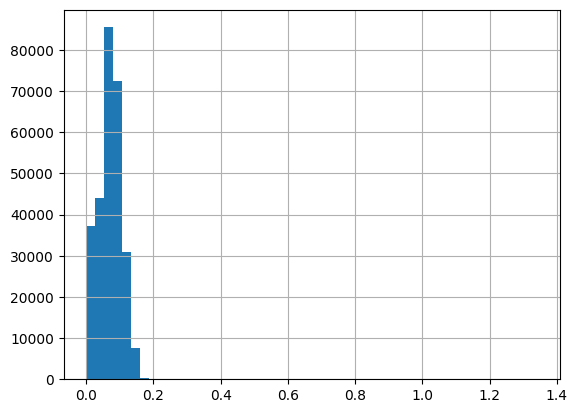

In [14]:
# discount (there are some outlier values!)
df_train['SnSDiscount'].hist(bins=50)
plt.show()

In [15]:
# Max and min price (global)
print ('max:', df_train['Avg_Sales_Prc'].max())
print ('min:', df_train['Avg_Sales_Prc'].min())

max: 115.9
min: 0.34


In [16]:
# max price per BRAND
df_train.groupby(['BRAND'])[['Avg_Sales_Prc']].max()

,Avg_Sales_Prc
BRAND,
ALTOIDS,71.21000
DOVE,105.24000
EXTRA,54.69000
M&M,88.30000
ORBIT,77.44000
SKITTLES,38.49000
SNICKERS,99.36000
STARBURST,47.72000
TWIX,115.90000


In [17]:
# min price per BRAND
df_train.groupby(['BRAND'])[['Avg_Sales_Prc']].min()

,Avg_Sales_Prc
BRAND,
ALTOIDS,11.99000
DOVE,2.30000
EXTRA,1.02000
M&M,0.34000
ORBIT,5.69000
SKITTLES,13.75000
SNICKERS,1.86000
STARBURST,3.19000
TWIX,1.12000


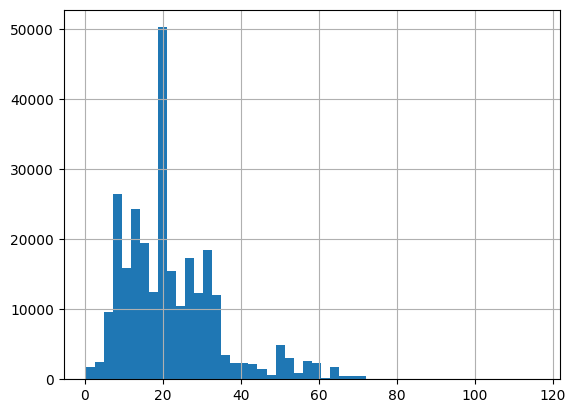

In [18]:
# average price
df_train['Avg_Sales_Prc'].hist(bins=50)
plt.show()

In [19]:
# grouping by BRAND
df_train.groupby(['BRAND'])[['Avg_Sales_Prc', 'ORD_UNITS', 'SnSDiscount', 'Brand_Spends', 'REP_OOS', 'Organic_Growth', 'Category_search_impressions',
'Category_search_clicks',
'Category_search_Spends']].mean()

,Avg_Sales_Prc,ORD_UNITS,SnSDiscount,Brand_Spends,REP_OOS,Organic_Growth,Category_search_impressions,Category_search_clicks,Category_search_Spends
BRAND,,,,,,,,,
ALTOIDS,29.42156,3.94964,0.06193,0.00000,3.02681,268.29538,0.00000,0.00000,0.00000
DOVE,18.44326,99.37025,0.07710,1.72637,3.50770,326.30876,"4,604.17241",12.55971,23.48620
EXTRA,22.81003,19.65744,0.05948,0.96029,3.45671,342.70184,"1,518.16534",3.06463,7.87826
M&M,29.29404,31.24682,0.08010,1.41978,3.24331,325.00793,"3,121.24680",5.26562,13.17139
ORBIT,18.81438,60.86170,0.05952,2.19946,2.87943,337.21340,"4,916.95787",8.35069,22.51294
SKITTLES,25.37421,22.13184,0.06759,0.00000,3.89087,341.53147,0.00000,0.00000,0.00000
SNICKERS,14.09931,92.92444,0.05892,1.56439,4.47614,327.90766,"1,920.77625",5.58397,12.39234
STARBURST,19.27290,57.84725,0.05658,1.29122,6.34436,331.58394,"2,598.50250",5.14444,13.11737
TWIX,22.59244,146.02827,0.09529,3.95296,5.13783,339.99256,"6,676.50444",10.94288,26.32723


In [20]:
# grouping by BRAND
df_test.groupby(['BRAND'])[['Avg_Sales_Prc', 'ORD_UNITS', 'SnSDiscount', 'Brand_Spends', 'REP_OOS', 'Organic_Growth', 'Dietary_Research_clicks',
'Dietary_Research_impressions',
'Dietary_Research_Spends']].mean()

,Avg_Sales_Prc,ORD_UNITS,SnSDiscount,Brand_Spends,REP_OOS,Organic_Growth,Dietary_Research_clicks,Dietary_Research_impressions,Dietary_Research_Spends
BRAND,,,,,,,,,
ALTOIDS,28.67760,NaN,0.00400,0.00000,83.41720,NaN,0.00000,0.00000,0.00000
DOVE,18.04689,NaN,0.06769,0.35433,7.17610,NaN,2.10690,937.30026,4.44131
EXTRA,22.99213,NaN,0.05493,1.76411,5.50077,NaN,0.91802,748.94009,1.64710
M&M,30.03768,NaN,0.06981,3.60935,5.69841,NaN,5.10466,"4,666.69599",13.04491
ORBIT,18.54871,NaN,0.05847,4.61170,6.45150,NaN,11.51969,"8,308.89808",34.76234
SKITTLES,23.58714,NaN,0.06122,0.00000,12.99244,NaN,0.00000,0.00000,0.00000
SNICKERS,13.10383,NaN,0.05369,1.28531,11.22257,NaN,4.91858,"3,417.24181",14.47751
STARBURST,19.06410,NaN,0.05724,2.07233,6.00157,NaN,2.88806,"2,010.09199",6.01697
TWIX,22.28241,NaN,0.08413,7.36077,6.02372,NaN,8.33952,"7,990.04999",23.42588


In [21]:
# grouping by CBU
df_train.groupby(['CBU'])[['Avg_Sales_Prc', 'ORD_UNITS', 'SnSDiscount', 'Brand_Spends', 'REP_OOS', 'Organic_Growth', 'Category_search_impressions',
'Category_search_clicks',
'Category_search_Spends']].mean()

,Avg_Sales_Prc,ORD_UNITS,SnSDiscount,Brand_Spends,REP_OOS,Organic_Growth,Category_search_impressions,Category_search_clicks,Category_search_Spends
CBU,,,,,,,,,
CHOCOLATE,22.67458,69.50371,0.07606,1.94420,3.79324,330.21901,"3,691.75218",7.15535,17.15195
FRUITY CONFECTIONARY,19.78867,54.82806,0.05751,1.18206,6.13695,332.42486,"2,378.83870",4.70955,12.00850
GUM,20.69093,41.51021,0.05950,1.61748,3.15055,339.79103,"3,320.72232",5.86810,15.63979
MINTS,29.42156,3.94964,0.06193,0.00000,3.02681,268.29538,0.00000,0.00000,0.00000


In [22]:
# grouping by day of week
df_train.groupby(['DayOfWeek'])[['Avg_Sales_Prc', 'ORD_UNITS', 'SnSDiscount', 'Brand_Spends', 'REP_OOS', 'Organic_Growth']].mean()

,Avg_Sales_Prc,ORD_UNITS,SnSDiscount,Brand_Spends,REP_OOS,Organic_Growth
DayOfWeek,,,,,,
Fri,22.12513,61.26684,0.07162,1.69499,4.13515,330.51228
Mon,22.11218,67.33963,0.07056,1.85943,3.95867,332.70113
Sat,22.14808,59.53964,0.07168,1.74887,3.68143,331.16429
Sun,22.10244,63.14602,0.07039,1.80599,3.76837,331.80651
Thu,22.14537,60.62828,0.07128,1.66550,4.08163,329.47792
Tue,22.15314,61.85717,0.07021,1.76404,4.41911,330.95875
Wed,22.13917,62.26795,0.07079,1.76482,3.98884,328.21680


In [23]:
# grouping by covid flag
df_train.groupby(['postCovid'])[['Avg_Sales_Prc', 'ORD_UNITS', 'SnSDiscount', 'Brand_Spends', 'REP_OOS', 'Organic_Growth']].mean()

,Avg_Sales_Prc,ORD_UNITS,SnSDiscount,Brand_Spends,REP_OOS,Organic_Growth
postCovid,,,,,,
0,22.13217,51.65893,0.07027,1.09053,2.10225,256.16364
1,22.13217,84.73156,0.07232,3.16509,8.01667,487.92545


In [24]:
# pivot table
pd.pivot_table(df_train, values='ORD_UNITS', index=['CBU'], columns=['DayOfWeek'], aggfunc=np.sum)

DayOfWeek,Fri,Mon,Sat,Sun,Thu,Tue,Wed
CBU,,,,,,,
CHOCOLATE,1913589,2111899,1857847,1966415,1896828,1911963,1948896
FRUITY CONFECTIONARY,294559,304203,281203,306547,289151,290486,295057
GUM,228347,262045,221272,240732,228829,226746,230437
MINTS,3028,3115,2866,3117,2987,3029,2878


<AxesSubplot:xlabel='DayOfWeek'>

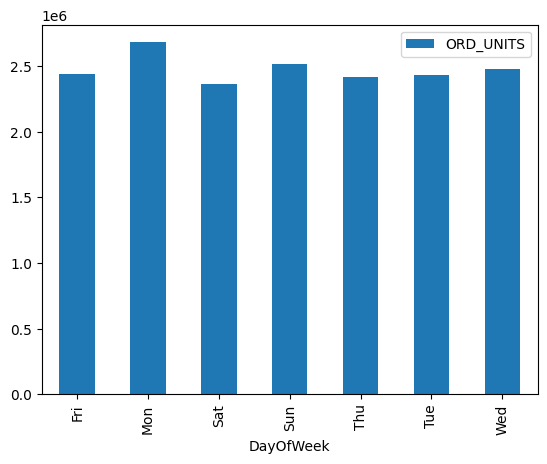

In [25]:
# barplot (day of week)
df_train.groupby(['DayOfWeek'])['ORD_UNITS'].sum().reset_index().plot(x='DayOfWeek', y='ORD_UNITS', kind='bar')

<AxesSubplot:xlabel='DayOfWeek', ylabel='ORD_UNITS'>

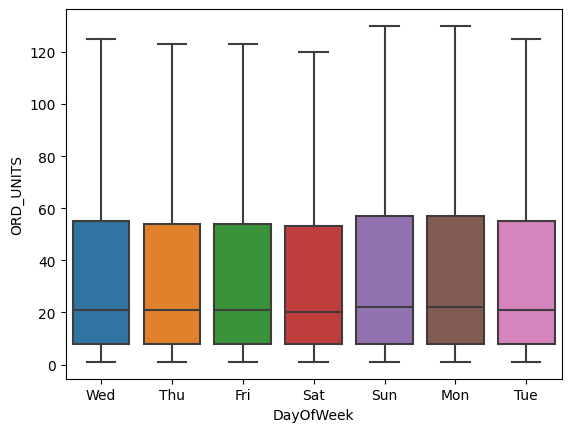

In [26]:
# boxplot (day of week vs. total units sold)
sns.boxplot(data=df_train, x="DayOfWeek", y="ORD_UNITS", showfliers = False)

<AxesSubplot:xlabel='MonthOfYear', ylabel='ORD_UNITS'>

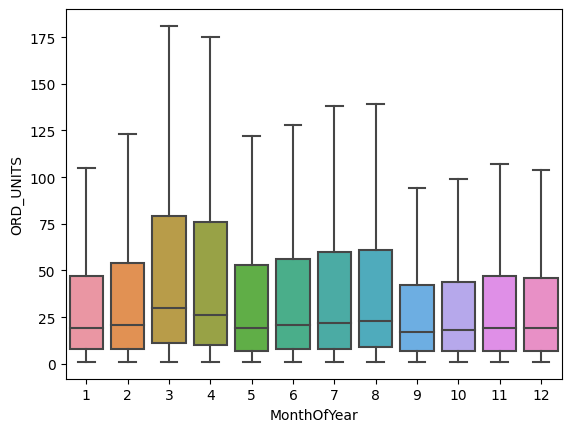

In [27]:
# box plot (month of the year vs. total units sold)
sns.boxplot(data=df_train, x="MonthOfYear", y="ORD_UNITS", showfliers = False)

In [28]:
# share of brands (units per brand (percentage))
df_sum = df_train.groupby(['BRAND'])['ORD_UNITS'].sum()
df_sum = df_sum / sum(df_sum)
df_sum.sort_values(ascending=False)

BRAND
TWIX          0.28561
SNICKERS      0.14890
M&M           0.13664
STARBURST     0.11489
VARIETY BAG   0.10948
DOVE          0.10464
ORBIT         0.07352
EXTRA         0.02103
SKITTLES      0.00406
ALTOIDS       0.00121
Name: ORD_UNITS, dtype: float64

In [29]:
# share of brands (units per brand (percentage))
df_sum = df_train.groupby(['BRAND'])['Avg_Sales_Prc'].sum()
df_sum = df_sum / sum(df_sum)
df_sum.sort_values(ascending=False)

BRAND
M&M           0.36057
TWIX          0.12437
VARIETY BAG   0.11788
STARBURST     0.10774
EXTRA         0.06868
ORBIT         0.06397
SNICKERS      0.06359
DOVE          0.05466
ALTOIDS       0.02543
SKITTLES      0.01310
Name: Avg_Sales_Prc, dtype: float64

In [30]:
# average price per CBU
df_train.groupby(['CBU'])['Avg_Sales_Prc'].mean()

CBU
CHOCOLATE              22.67458
FRUITY CONFECTIONARY   19.78867
GUM                    20.69093
MINTS                  29.42156
Name: Avg_Sales_Prc, dtype: float64

In [31]:
df_train.groupby('DATE')['ORD_UNITS'].sum().sort_values(ascending=False)

DATE
2019-07-15    177120
2019-11-29     83872
2020-03-16     81005
2020-03-17     79370
2020-03-13     71936
               ...  
2019-06-08     22112
2019-07-04     21852
2019-05-04     21718
2019-05-25     21695
2019-05-11     21597
Name: ORD_UNITS, Length: 475, dtype: int64

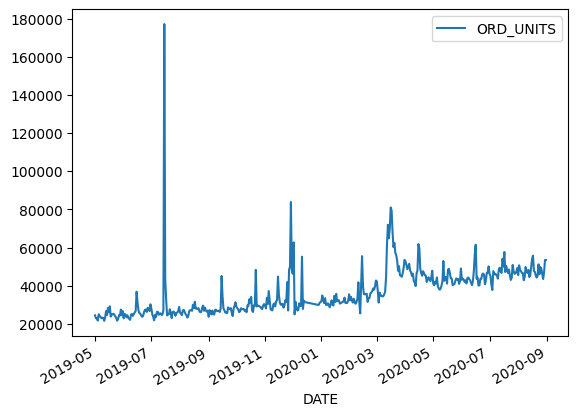

In [32]:
df_train.groupby(['DATE'])['ORD_UNITS'].sum().reset_index().plot(x='DATE', y='ORD_UNITS')
plt.show()

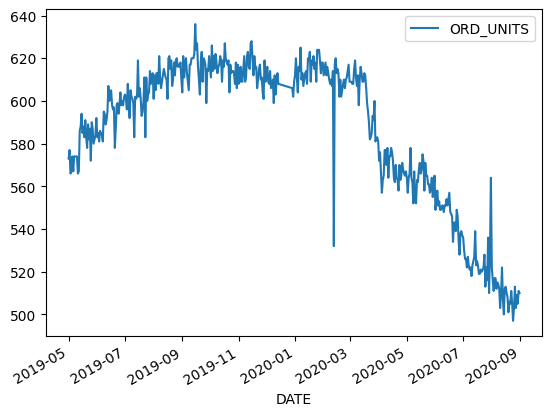

In [33]:
df_train.groupby(['DATE'])['ORD_UNITS'].count().reset_index().plot(x='DATE', y='ORD_UNITS')
plt.show()

Perason r (correlation): 0.38


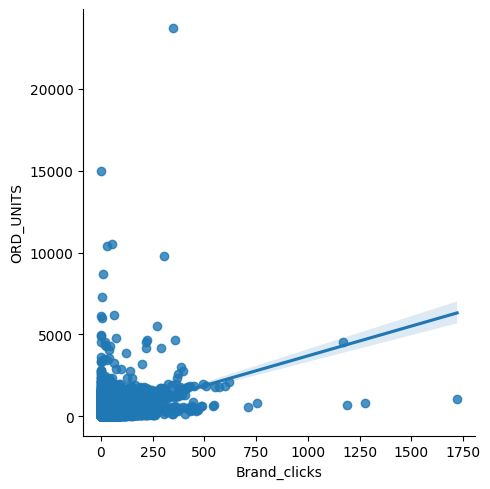

In [34]:
# correlation plot between brand clicks and ord units
print ('Perason r (correlation):', round(stats.pearsonr(df_train['Brand_clicks'], df_train['ORD_UNITS'])[0], 2))
sns.lmplot(x="Brand_clicks", y="ORD_UNITS", data=df_train)

Perason r (correlation): 0.31


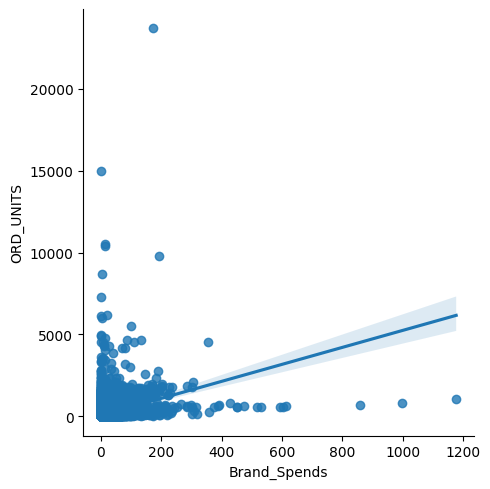

In [35]:
# correlation plot between brand spends and ord units
print ('Perason r (correlation):', round(stats.pearsonr(df_train['Brand_Spends'], df_train['ORD_UNITS'])[0], 2))
sns.lmplot(x="Brand_Spends", y="ORD_UNITS", data=df_train)

Perason r (SnSDiscount): 0.31


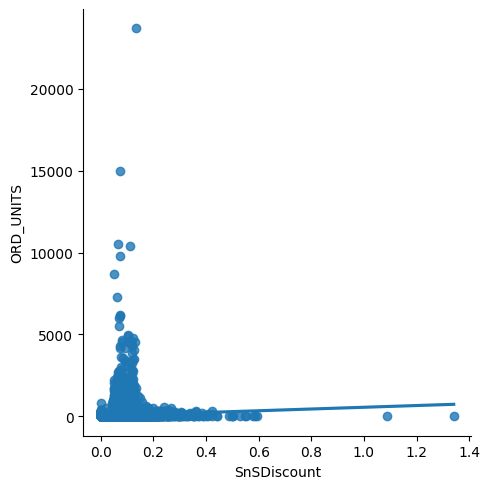

In [36]:
# correlation plot between brand spends and ord units
print ('Perason r (SnSDiscount):', round(stats.pearsonr(df_train['Brand_Spends'], df_train['ORD_UNITS'])[0], 2))
sns.lmplot(x="SnSDiscount", y="ORD_UNITS", data=df_train)

In [37]:
# Correlations (brand clicks and spends correlate best with the target, as expected)
# Discount also correlates well (as expected, more discount equals more units sold)
target = 'ORD_UNITS'
df_corr = pd.DataFrame(df_train.sample(10_000).corr()[target]).reset_index()
df_corr.columns = ['Feature', 'Correlation']
df_corr = df_corr.query("Feature != @target")
df_corr['Correlation_Abs'] = np.abs(df_corr['Correlation'])
df_corr = df_corr.sort_values(by=['Correlation_Abs'], ascending=False)
df_corr = df_corr.reset_index(drop=True)
df_corr = df_corr.iloc[1:, :].reset_index(drop=True)
df_corr

,Feature,Correlation,Correlation_Abs
0,DOTDPrime_Day_tp_PromoFlag,0.36765,0.36765
1,DOTD_SC_PromoFlag,0.35818,0.35818
2,Brand_impressions,0.30433,0.30433
3,Brand_clicks,0.27449,0.27449
4,Competitive_clicks,0.27239,0.27239
5,TradePromoFlag,0.25725,0.25725
6,Category_search_impressions,0.24451,0.24451
7,Competitive_impressions,0.23150,0.23150
8,Category_search_clicks,0.20521,0.20521
9,Brand_Spends,0.20488,0.20488


In [38]:
# more analysis
profile = ProfileReport(df_train, explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 2. Attribution Model (part 1: understanding training data)

In [39]:
list(set(df_train.columns.tolist()) - set(df_test.columns.tolist()))

['Category_search_impressions',
 'Category_search_clicks',
 'Category_search_Spends']

In [40]:
list(set(df_test.columns.tolist()) - set(df_train.columns.tolist()))

['Dietary_Research_clicks',
 'Dietary_Research_impressions',
 'Dietary_Research_Spends']

In [41]:
X_columns = ['ASIN_anon',
'BRAND',
'CBU',
'Avg_Sales_Prc',
'Brand_Spends',
'Brand_clicks',
'Brand_impressions',
'Category_Adjacent_Spends',
'Competitive_clicks',
'Competitive_impressions',
'DOTDPrime_Day_tp_PromoFlag',
'DOTD_SC_PromoFlag',
'DayOfWeek',
'Category_search_Spends',
'Category_search_clicks',
'Category_search_impressions',
'GLANCE_VIEWS',
'MonthOfYear',
'Organic_Growth',
'PRIME_DAY',
'REP_OOS',
'SnSDiscount',
'TradePromoFlag',
'postCovid']

In [42]:
# sample data
df_train = df_train.sample(frac=0.2)
df_train_full = df_train.copy()

# convert cat cols
list_cat_cols = ['BRAND', 'CBU', 'DayOfWeek', 'ASIN_anon']

# convert to categorical feature
for col in list_cat_cols:
    df_train[col] = pd.Series(df_train[col], dtype="category").cat.codes

    
# Time Split
# date split
date_split = "2020-05-01"

# train, val and test data sets
df_train_model = df_train.query('DATE < @date_split')
df_val_model = df_train.query('DATE >= @date_split')

# train and val
X_train = df_train_model[X_columns]
X_val = df_val_model[X_columns]
y_train = df_train_model.loc[:, target]
y_val = df_val_model.loc[:, target]

# full df
X = df_train[X_columns]
y = df_train.loc[:, target]

print (X_train.shape, y_train.shape, X_val.shape, y_val.shape)

(42593, 24) (42593,) (13040, 24) (13040,)


### Grid Search

In [43]:
# Create parameters to search
param_grid = {
    'n_estimators': [140, 150, 160],
    'max_depth': [40, 45],
    'num_leaves': [40, 45],
    'min_data_in_leaf': [40, 45],
    'reg_alpha': [0.05],
    }


# LightGBM Regressor
model_grid_search = RandomizedSearchCV(lgb.LGBMRegressor(random_state=42),
                                       param_distributions=param_grid,
                                       n_iter = 20,
                                       scoring=rmse_scorer,
                                       n_jobs=-1,
                                       verbose=1)

# fit
model_grid_search.fit(X_train, y_train)

# grid search to find best results
model_grid_search.fit(X_train, y_train)

# Print the best parameters found
print(model_grid_search.best_params_)
print(abs(model_grid_search.best_score_))

Fitting 5 folds for each of 20 candidates, totalling 100 fits
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
Fitting 5 folds for each of 20 candidates, totalling 100 fits
{'reg_alpha': 0.05, 'num_leaves': 40, 'n_estimators': 160, 'min_data_in_leaf': 45, 'max_depth': 45}
82.8127295257612


### Final model

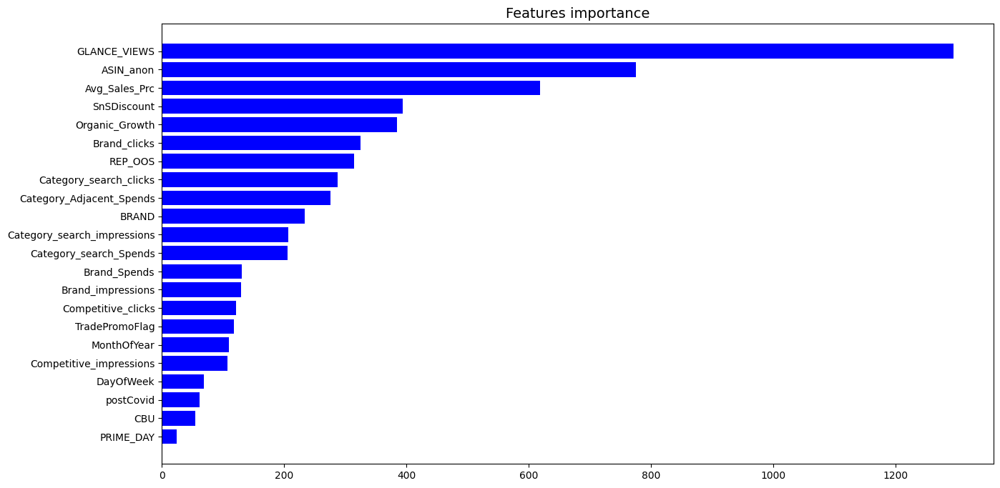

Features:
['GLANCE_VIEWS', 'ASIN_anon', 'Avg_Sales_Prc', 'SnSDiscount', 'Organic_Growth', 'Brand_clicks', 'REP_OOS', 'Category_search_clicks', 'Category_Adjacent_Spends', 'BRAND', 'Category_search_impressions', 'Category_search_Spends', 'Brand_Spends', 'Brand_impressions', 'Competitive_clicks', 'TradePromoFlag', 'MonthOfYear', 'Competitive_impressions', 'DayOfWeek', 'postCovid', 'CBU', 'PRIME_DAY']
MAE: 29.467407975460123
MSE: 5522.570782208589
RMSE: 74.31400125284998


In [44]:
# Training
model = model_grid_search.best_estimator_

# Prediction
y_pred_train = model.predict(X_train)

# feature importances
features_importances = model.booster_.feature_importance()
df_features = plot_feature_importance(X_columns, features_importances, 40)
list_final_features = df_features['Feature'].values.tolist()

print ('Features:')
print (list_final_features)

# pred
y_pred_val = [1 if value < 1 else round(value) for value in model.predict(X_val)]
df_val_model['ORD_UNITS_pred'] = y_pred_val

# metrics
print ('MAE:', mae_score(y_val, y_pred_val))
print ('MSE:', mse_score(y_val, y_pred_val))
print ('RMSE:', rmse_score(y_val, y_pred_val))

In [45]:
# sample of results
df_val_model[['ORD_UNITS', 'ORD_UNITS_pred']].sample(20)

,ORD_UNITS,ORD_UNITS_pred
13056,34,57
2536,193,173
241188,65,44
100935,273,234
264886,52,60
16736,34,33
88824,20,23
272355,2,7
245150,23,49
9396,138,175


<AxesSubplot:>

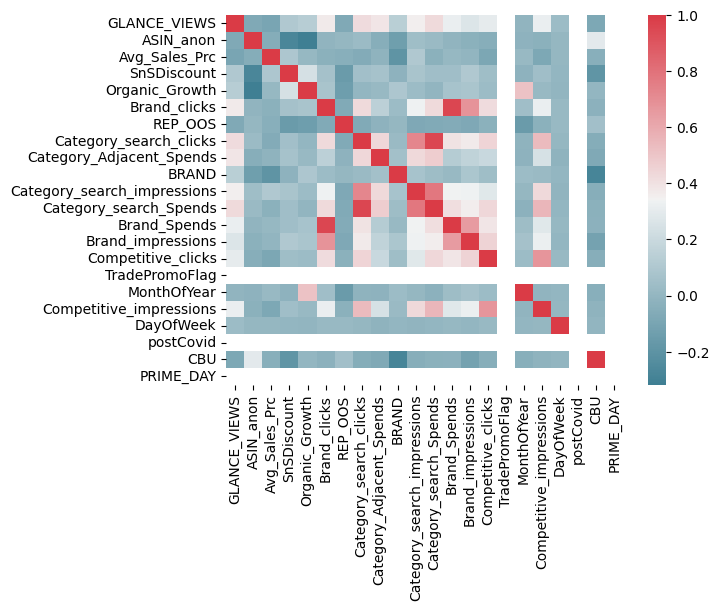

In [46]:
### Feature correlation
corr = df_val_model[list_final_features].corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool),
            cmap=sns.diverging_palette(220, 10, as_cmap=True))

### Shap Values

CPU times: user 1e+03 ns, sys: 2 µs, total: 3 µs
Wall time: 6.44 µs


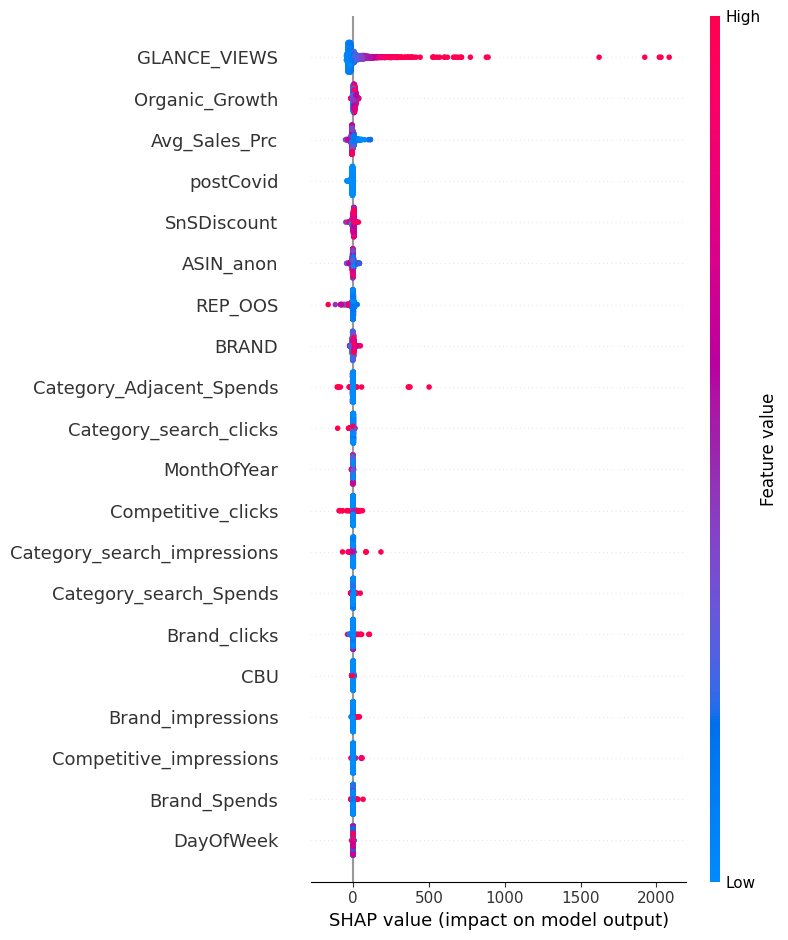

In [47]:
%time
X = df_val_model[X_columns].sample(frac=0.1)
shap_values = shap.TreeExplainer(model).shap_values(X)
shap.summary_plot(shap_values, X)

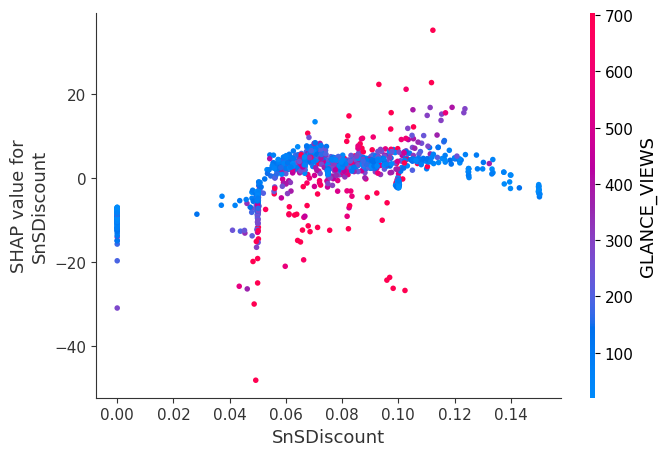

In [48]:
shap.dependence_plot("SnSDiscount", shap_values, X)

## 2. Attribution Model (part 2: predicting test data)

In [49]:
X_columns = ['ASIN_anon',
'BRAND',
'CBU',
'Avg_Sales_Prc',
'Brand_impressions',
'Category_Adjacent_Spends',
'Competitive_clicks',
'Competitive_impressions',
'DOTDPrime_Day_tp_PromoFlag',
'DOTD_SC_PromoFlag',
'DayOfWeek',
'MonthOfYear',
'PRIME_DAY',
'REP_OOS',
'SnSDiscount',
'TradePromoFlag',
'postCovid']

In [50]:
# convert cat cols
list_cat_cols = ['BRAND', 'CBU', 'DayOfWeek', 'ASIN_anon']

for col in list_cat_cols:
    df_train[col] = pd.Series(df_train[col], dtype="category").cat.codes
    df_test[col] = pd.Series(df_test[col], dtype="category").cat.codes

# Time Split
# date split
date_split = "2020-05-01"

# train, val and test data sets
df_train_model = df_train.query('DATE < @date_split')
df_val_model = df_train.query('DATE >= @date_split')

# train and val
X_train = df_train_model[X_columns]
X_val = df_val_model[X_columns]
y_train = df_train_model.loc[:, target]
y_val = df_val_model.loc[:, target]
X_test = df_test[X_columns]
y_test = df_test.loc[:, target]

# full df
X = df_train[X_columns]
y = df_train.loc[:, target]

print (X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape)

(42593, 17) (42593,) (13040, 17) (13040,) (30237, 17) (30237,)


### Grid Search

In [51]:
# Create parameters to search
param_grid = {
    'n_estimators': [140, 150, 160],
    'max_depth': [40, 45],
    'num_leaves': [40, 45],
    'min_data_in_leaf': [40, 45],
    'reg_alpha': [0.05],
    }


# LightGBM Regressor
model_grid_search = RandomizedSearchCV(lgb.LGBMRegressor(random_state=42),
                                       param_distributions=param_grid,
                                       n_iter = 20,
                                       scoring=rmse_scorer,
                                       n_jobs=-1,
                                       verbose=1)

# fit
model_grid_search.fit(X_train, y_train)

# grid search to find best results
model_grid_search.fit(X_train, y_train)

# Print the best parameters found
print(model_grid_search.best_params_)
print(abs(model_grid_search.best_score_))

Fitting 5 folds for each of 20 candidates, totalling 100 fits
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
Fitting 5 folds for each of 20 candidates, totalling 100 fits
{'reg_alpha': 0.05, 'num_leaves': 45, 'n_estimators': 160, 'min_data_in_leaf': 45, 'max_depth': 45}
98.63184353657253


### Final model

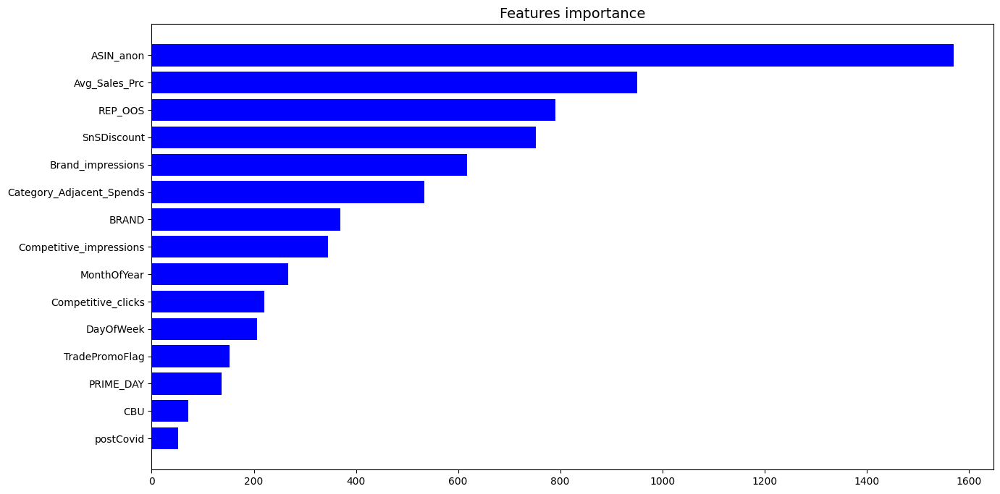

Features:
['ASIN_anon', 'Avg_Sales_Prc', 'REP_OOS', 'SnSDiscount', 'Brand_impressions', 'Category_Adjacent_Spends', 'BRAND', 'Competitive_impressions', 'MonthOfYear', 'Competitive_clicks', 'DayOfWeek', 'TradePromoFlag', 'PRIME_DAY', 'CBU', 'postCovid']
Pred (sum): 860983
True (sum): 2351853
MAE: 43.85529141104294
MSE: 7837.399923312883
RMSE: 88.52909083071442


In [52]:
# Training
model = model_grid_search.best_estimator_

# Prediction
y_pred_train = model.predict(X_train)

# feature importances
features_importances = model.booster_.feature_importance()
df_features = plot_feature_importance(X_columns, features_importances, 40)
list_final_features = df_features['Feature'].values.tolist()

print ('Features:')
print (list_final_features)

# pred
y_pred_val = [1 if value < 1 else round(value) for value in model.predict(X_val)]
df_val_model['ORD_UNITS_pred'] = y_pred_val

# pred
y_pred_test = [1 if value < 1 else round(value) for value in model.predict(X_test)]
df_test['ORD_UNITS_pred'] = y_pred_test

# metrics
print ('Pred (sum):', np.sum(y_pred_val))
print ('True (sum):', np.sum(y_train))
print ('MAE:', mae_score(y_val, y_pred_val))
print ('MSE:', mse_score(y_val, y_pred_val))
print ('RMSE:', rmse_score(y_val, y_pred_val))

In [53]:
# sample of results (val)
df_val_model[['ORD_UNITS', 'ORD_UNITS_pred']].sample(20)

,ORD_UNITS,ORD_UNITS_pred
94413,23,27
25540,59,34
5721,24,61
64539,146,28
260810,37,23
180234,56,32
99508,90,45
58960,38,134
67083,2,17
220333,47,135


In [54]:
# sample of results (test)
df_test[['ORD_UNITS', 'ORD_UNITS_pred']].sample(20)

,ORD_UNITS,ORD_UNITS_pred
11575,NaN,32
15907,NaN,92
24904,NaN,25
26368,NaN,18
10219,NaN,55
23863,NaN,69
13750,NaN,38
4997,NaN,127
28979,NaN,36
29323,NaN,33


In [55]:
# save results (csv)
print (df_test.shape)
df_test.to_csv('df_test_predictions.csv', index=False)
df_test.head()

(30237, 27)


,ASIN_anon,DATE,BRAND,CBU,Avg_Sales_Prc,Brand_Spends,Brand_clicks,Brand_impressions,Category_Adjacent_Spends,Competitive_clicks,...,GLANCE_VIEWS,MonthOfYear,Organic_Growth,PRIME_DAY,REP_OOS,SnSDiscount,TradePromoFlag,postCovid,ORD_UNITS,ORD_UNITS_pred
0,0,2020-10-09,3,0,21.36000,0.00000,NaN,NaN,0.00000,0,...,NaN,10,NaN,0,75.00000,0.00000,0,1,NaN,26
1,1,2020-09-15,3,0,21.36000,0.00000,NaN,NaN,0.00000,0,...,NaN,9,NaN,0,100.00000,0.00000,0,1,NaN,24
2,2,2020-09-01,3,0,21.36000,0.00000,NaN,NaN,0.00000,0,...,NaN,9,NaN,0,3.57000,0.04994,0,1,NaN,52
3,2,2020-09-02,3,0,21.36000,0.00000,NaN,NaN,0.00000,0,...,NaN,9,NaN,0,2.27000,0.05009,0,1,NaN,48
4,2,2020-09-03,3,0,21.36000,0.00000,NaN,NaN,0.00000,0,...,NaN,9,NaN,0,2.27000,0.00000,0,1,NaN,49


<AxesSubplot:>

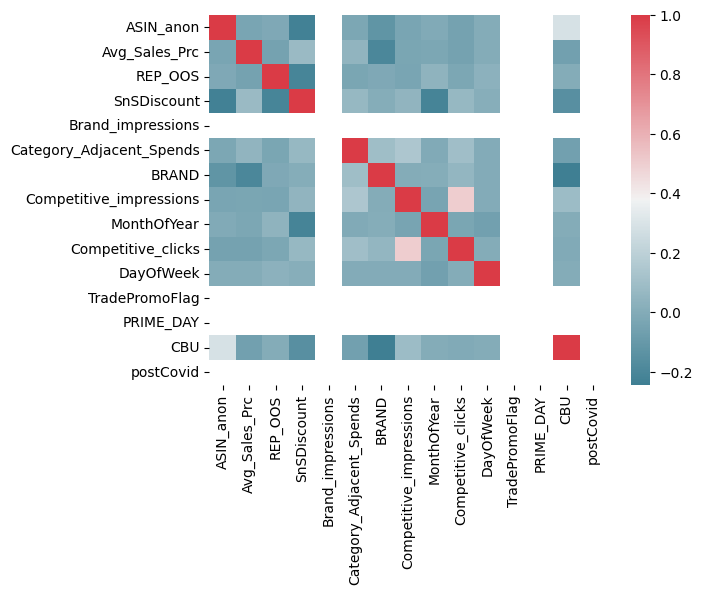

In [56]:
### Feature correlation
corr = df_test[list_final_features].corr()
sns.heatmap(corr, mask=np.zeros_like(corr, dtype=np.bool),
            cmap=sns.diverging_palette(220, 10, as_cmap=True))

### Shap Values

CPU times: user 1e+03 ns, sys: 1e+03 ns, total: 2 µs
Wall time: 5.25 µs


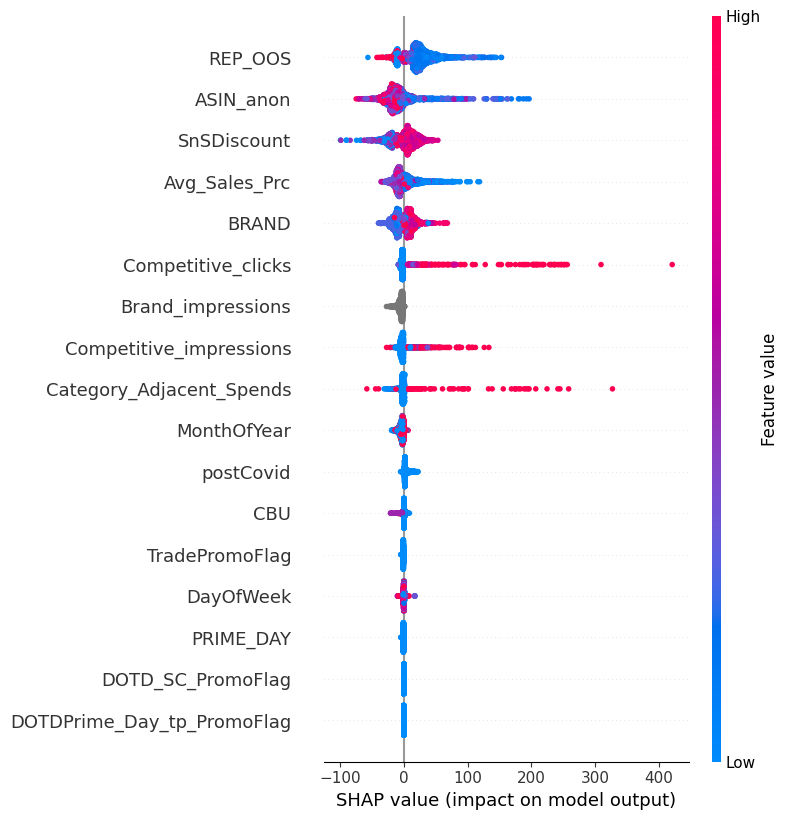

In [57]:
%time
X = df_test[X_columns].sample(frac=0.1)
shap_values = shap.TreeExplainer(model).shap_values(X)
shap.summary_plot(shap_values, X)

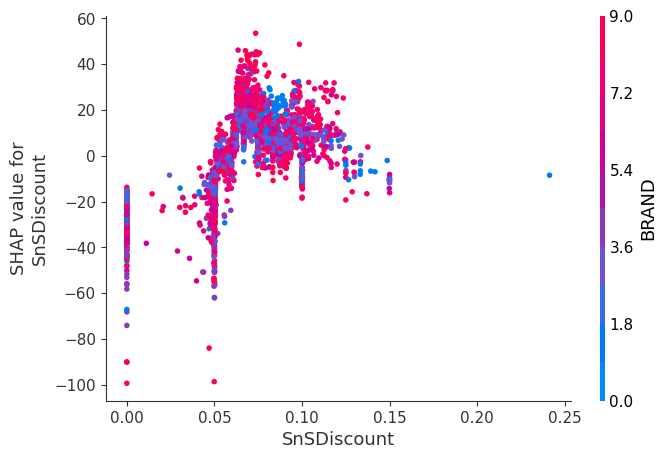

In [58]:
shap.dependence_plot("SnSDiscount", shap_values, X)

## 3. Discount optimization (Brand Level)

### Strategy

In [59]:
# I am finding the optimal discount value by calculating, on a Brand/CBU/day level, the highest value
# of delta difference between ORD_UNITS for each discount value (simmilar to a derivative approach)
# Then the values are aggregated on a Brand level or a Brand and day level (for more advanced strategies)

# For this step, our approach will be to utilize all the features that we have before on the train dataset
# before selling the product. This means that the features related to clicks and "post-selling"
# information will not be used, because they can be considered "future information" in this context
# Have in mind that, since there is no clear metadata, the features which I considered to be "future info"
# May not be correct, depending on business knowledge and context

# There are others ways to solve this problem, for example using a logistic regression
# and using the coefficients to solve for the optimal value of discount

In [60]:
# fair columns
X_columns = ['ASIN_anon',
'BRAND',
'CBU',
'Avg_Sales_Prc',
'Brand_Spends',
'Category_Adjacent_Spends',
'DOTDPrime_Day_tp_PromoFlag',
'DOTD_SC_PromoFlag',
'DayOfWeek',
'Category_search_Spends',
'MonthOfYear',
'Organic_Growth',
'PRIME_DAY',
'REP_OOS',
'SnSDiscount',
'TradePromoFlag',
'postCovid']

In [61]:
# convert cat cols
list_cat_cols = ['BRAND', 'CBU', 'DayOfWeek', 'ASIN_anon']

# convert to categorical feature
for col in list_cat_cols:
    df_train[col] = pd.Series(df_train[col], dtype="category").cat.codes

    
# Time Split
# date split
date_split = "2020-05-01"

# train, val and test data sets
df_train_model = df_train.query('DATE < @date_split')
df_val_model = df_train.query('DATE >= @date_split')

# train and val
X_train = df_train_model[X_columns]
X_val = df_val_model[X_columns]
y_train = df_train_model.loc[:, target]
y_val = df_val_model.loc[:, target]

# full df
X = df_train[X_columns]
y = df_train.loc[:, target]

print (X_train.shape, y_train.shape, X_val.shape, y_val.shape)

(42593, 17) (42593,) (13040, 17) (13040,)


### Grid Search

In [62]:
# Create parameters to search
param_grid = {
    'n_estimators': [140, 150, 160],
    'max_depth': [40, 45],
    'num_leaves': [40, 45],
    'min_data_in_leaf': [40, 45],
    'reg_alpha': [0.05],
    }


# LightGBM Regressor
model_grid_search = RandomizedSearchCV(lgb.LGBMRegressor(random_state=42),
                                       param_distributions=param_grid,
                                       n_iter = 20,
                                       scoring=rmse_scorer,
                                       n_jobs=-1,
                                       verbose=1)

# fit
model_grid_search.fit(X_train, y_train)

# grid search to find best results
model_grid_search.fit(X_train, y_train)

# Print the best parameters found
print(model_grid_search.best_params_)
print(abs(model_grid_search.best_score_))

Fitting 5 folds for each of 20 candidates, totalling 100 fits
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
Fitting 5 folds for each of 20 candidates, totalling 100 fits
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] m

[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min

[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min

[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min

{'reg_alpha': 0.05, 'num_leaves': 45, 'n_estimators': 160, 'min_data_in_leaf': 45, 'max_depth': 45}
95.61351193196822


### Final model

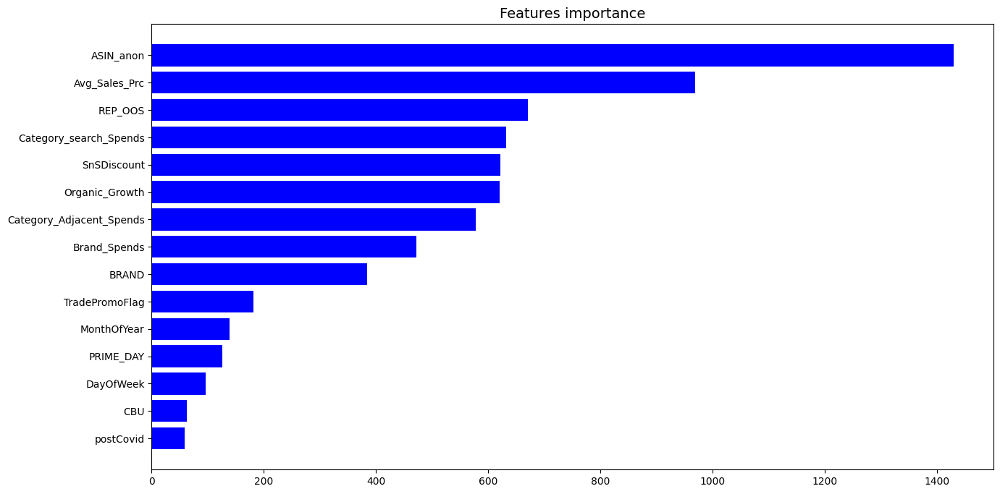

Features:
['ASIN_anon', 'Avg_Sales_Prc', 'REP_OOS', 'Category_search_Spends', 'SnSDiscount', 'Organic_Growth', 'Category_Adjacent_Spends', 'Brand_Spends', 'BRAND', 'TradePromoFlag', 'MonthOfYear', 'PRIME_DAY', 'DayOfWeek', 'CBU', 'postCovid']
MAE: 52.17223926380368
MSE: 6830.87791411043
RMSE: 82.64912530759433


In [63]:
# Training
model = model_grid_search.best_estimator_

# Prediction
y_pred_train = model.predict(X_train)

# feature importances
features_importances = model.booster_.feature_importance()
df_features = plot_feature_importance(X_columns, features_importances, 40)
list_final_features = df_features['Feature'].values.tolist()

print ('Features:')
print (list_final_features)

# pred val
y_pred_val = [1 if value < 1 else round(value) for value in model.predict(X_val)]
df_val_model['ORD_UNITS_pred'] = y_pred_val

# pred full train data
y_pred = [1 if value < 1 else round(value) for value in model.predict(X)]
df_train['ORD_UNITS_pred'] = y_pred

# metrics
print ('MAE:', mae_score(y_val, y_pred_val))
print ('MSE:', mse_score(y_val, y_pred_val))
print ('RMSE:', rmse_score(y_val, y_pred_val))

df_val_model_copy = df_val_model.copy()

In [64]:
# sample of results
df_train[['ORD_UNITS', 'ORD_UNITS_pred']].sample(20)

,ORD_UNITS,ORD_UNITS_pred
222642,50,47
123496,13,20
131937,81,52
149525,567,492
156128,54,23
158811,38,31
231030,24,30
220527,38,33
56140,7,24
210719,15,130


### Discount Optimization

In [65]:
# discount list (iterate using a 0.25% step)
discount_list = np.arange(0, 0.201, 0.0025)

# initialization
list_optimal_discount = []
list_optimal_amount = []

# optimization
for item in range(len(X)):
    array_features = np.array(X.iloc[item, :]).reshape(1, -1)
    list_preds = []
    
    # iterate on the discount list
    for discount in discount_list:
        # discount value
        array_features[0][-3] = discount
        
        # prediction
        pred = round(model.predict(array_features)[0])
        
        # sanity treatment
        if pred < 1:
            pred = 1
        
        # append values
        list_preds.append(pred)

    # list difference
    list_difference = []

    # find optimal value
    for index in range(len(list_preds)-1):
        diff = list_preds[index+1] - list_preds[index]
        list_difference.append(diff)
    list_difference.insert(0,-1)
    
    # optimal discount
    arg_max = np.argmax(list_difference)
    optimal_discount = discount_list[arg_max]
    optimal_value = list_preds[arg_max]
    
    # append optimal values
    list_optimal_discount.append(optimal_discount)
    list_optimal_amount.append(optimal_value)

# add values to df
df_train_full['ORD_UNITS_pred'] = df_train['ORD_UNITS_pred']
df_train_full['SnSDiscount_Optimal'] = list_optimal_discount
df_train_full['ORD_UNITS_Optimal'] = list_optimal_amount

[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] min

### Results

In [66]:
# Resulting data (sample of 20)
df_train_full[['BRAND', 'DayOfWeek', 'SnSDiscount', 'SnSDiscount_Optimal', 'ORD_UNITS', 'ORD_UNITS_pred', 'ORD_UNITS_Optimal']].sample(20)

,BRAND,DayOfWeek,SnSDiscount,SnSDiscount_Optimal,ORD_UNITS,ORD_UNITS_pred,ORD_UNITS_Optimal
102658,M&M,Thu,0.09229,0.10250,19,37,40
28251,DOVE,Wed,0.00000,0.10250,3,1,20
188156,M&M,Wed,0.00000,0.10250,3,3,16
118873,M&M,Sun,0.04985,0.10250,6,8,18
210410,ORBIT,Wed,0.10000,0.10250,12,10,23
151701,DOVE,Thu,0.08514,0.10250,31,27,29
79764,DOVE,Mon,0.08976,0.05250,209,170,169
72230,VARIETY BAG,Sat,0.07509,0.09500,16,42,57
182910,EXTRA,Mon,0.08251,0.09750,22,70,85
123887,STARBURST,Sat,0.05027,0.00250,9,22,32


In [69]:
# True and Optimal discount value on a Brand level
list_columns = ['SnSDiscount', 'SnSDiscount_Optimal']
groupby = df_train_full.groupby(['BRAND'])[list_columns].mean()
groupby.to_csv('Optimal_Discount.csv', index=False)
groupby

,SnSDiscount,SnSDiscount_Optimal
BRAND,,
ALTOIDS,0.06269,0.09040
DOVE,0.07614,0.07502
EXTRA,0.06022,0.08395
M&M,0.07967,0.07751
ORBIT,0.05981,0.06226
SKITTLES,0.06671,0.07978
SNICKERS,0.05893,0.04970
STARBURST,0.05624,0.05551
TWIX,0.09540,0.06358


In [70]:
# True and Optimal discount value on a Brand and day of the week level (more interesting approach)
df_train_full.groupby(['BRAND', 'DayOfWeek'])[list_columns].mean()

SnSDiscount  SnSDiscount_Optimal
BRAND       DayOfWeek                                  
ALTOIDS     Fri            0.06122              0.08899
            Mon            0.06173              0.09044
            Sat            0.06378              0.09180
            Sun            0.05657              0.08993
            Thu            0.06791              0.08984
            Tue            0.06398              0.08971
            Wed            0.06367              0.09208
DOVE        Fri            0.07533              0.07639
            Mon            0.07367              0.07458
            Sat            0.07738              0.07490
            Sun            0.07841              0.07538
            Thu            0.07775              0.07627
            Tue            0.07569              0.07355
            Wed            0.07465              0.07413
EXTRA       Fri            0.05994              0.08344
            Mon            0.05838              0.08194
            Sat            0.06189              0.08510
            Sun            0.06030              0.08548
            Thu            0.05999              0.08423
            Tue            0.06029              0.08354
            Wed            0.06069              0.08391
M&M         Fri            0.08080              0.07824
            Mon            0.08074              0.07831
            Sat            0.08129              0.07773
            Sun            0.07945              0.07708
            Thu            0.07812              0.07771
            Tue            0.07775              0.07710
            Wed            0.07969              0.07643
ORBIT       Fri            0.06264              0.06209
            Mon            0.05895              0.06324
            Sat            0.06149              0.06277
            Sun            0.05872              0.06243
            Thu            0.05875              0.06200
            Tue            0.05842              0.06147
            Wed            0.05971              0.06180
SKITTLES    Fri            0.07033              0.08250
            Mon            0.06417              0.07740
            Sat            0.06528              0.08144
            Sun            0.06384              0.07634
            Thu            0.06680              0.07760
            Tue            0.06395              0.07973
            Wed            0.07178              0.08276
SNICKERS    Fri            0.05950              0.04966
            Mon            0.05970              0.04943
            Sat            0.05902              0.04869
            Sun            0.05909              0.04898
            Thu            0.05888              0.05083
            Tue            0.05848              0.05075
            Wed            0.05784              0.04969
STARBURST   Fri            0.05563              0.05543
            Mon            0.05655              0.05645
            Sat            0.05775              0.05482
            Sun            0.05444              0.05447
            Thu            0.05680              0.05528
            Tue            0.05607              0.05535
            Wed            0.05649              0.05681
TWIX        Fri            0.09550              0.06291
            Mon            0.09641              0.06483
            Sat            0.09653              0.06282
            Sun            0.09507              0.06421
            Thu            0.09429              0.06302
            Tue            0.09485              0.06385
            Wed            0.09515              0.06345
VARIETY BAG Fri            0.06467              0.05821
            Mon            0.06031              0.05832
            Sat            0.06367              0.05819
            Sun            0.06348              0.05865
            Thu            0.06576              0.05800
            Tue            0.06460              0.05951
            Wed            0.06309             